-- <font color='gray'>**Adam Hughes**</font> 

-- <font color='gray'>**2/27/14**</font> 

-- <font color='gray'>**The George Washington University**</font> 

# Quantifying Segmentation Peformance: Global, Adaptive, Otsu, Canny, Watershed, Randomwalk

### Objective

::**DESCRIPTION OF OBJECTIVE**:: 


This guide follows closely a very nice, [simple segmentation comparison on an image of coins from scikit-image](http://scikit-image.org/docs/dev/auto_examples/applications/plot_coins_segmentation.html#example-applications-plot-coins-segmentation-py).

### Environment Setup

Configure notebook style (see NBCONFIG.ipynb), add imports and paths.  The **%run** magic used below <font color='red'>**requires IPython 2.0 or higher.**</font>  We also import *Otsu* and *Adaptive* thresholding from [skimage filter](http://scikit-image.org/docs/0.9.x/api/skimage.filter.html).

In [1]:
%pylab inline
%run NBCONFIG.ipynb

TEXTSIZE = 15
LEGENDSIZE = 11

Populating the interactive namespace from numpy and matplotlib


#### Load test images

   - *basic*: Rasterized particles, no smoothing, no noise.
   - *smooth*: Smoothed particles, no noise.
   - *noisy*: Smoothed and noise
 
A quick utility to return all three of these is **_shared.SEM_test_image()**  We will also load the binary image.

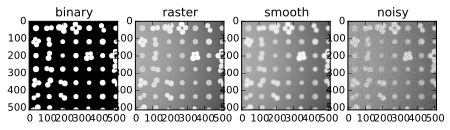

In [2]:
from _shared import load_test_image, SEM_test_images
from pyparty.plots import multishow
from pyparty.utils import crop, rgb2uint

AUTOCROP = (0, 0, 512, 512)
SHOWARGS = {'nolabel':True} # Turn of axis labels

binary = load_test_image('SEM_test_binary.png', crop=AUTOCROP).astype('bool')
basic, smooth, noisy = SEM_test_images(crop=AUTOCROP)

BIG3 = [basic, smooth, noisy]
BIG3GRAY = map(rgb2uint, BIG3)
NAMES = ['raster', 'smooth', 'noisy']
PIXELAREA = float(basic.shape[0] * basic.shape[1])

multishow([binary]+BIG3, names=['binary']+NAMES);

The deconstructed histogram to this noisy data was constructed in a related [Notebook](http://nbviewer.ipython.org/urls/raw.github.com/hugadams/pyparty/master/examples/Notebooks/test_data_V1.ipynb).

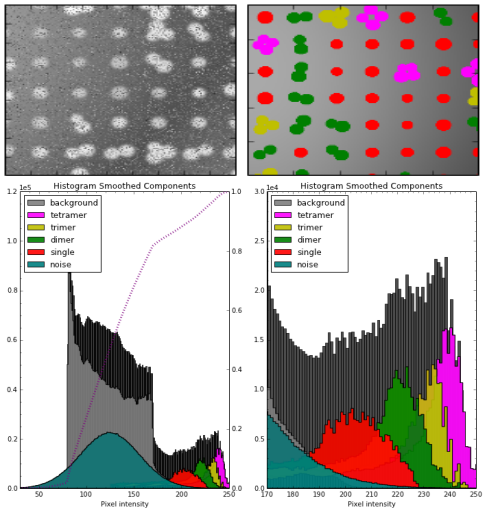

In [3]:
from IPython.display import Image
Image('../images/Preproc_Hist/hist_deconstruct.png')

### Global Threshold Optimization

The simplest wayt to threshold is to choose a global values and excluse pixels over or under this value.  This method only works when there is a gap between background and particles of interest.  Noise and smoothing obviously bridge this gap, so one will never get a perfect threshold; however, because of computational efficiency, we can sweep through parameters and show the optimzed threshold.

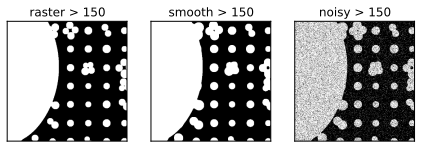

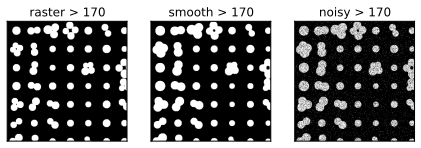

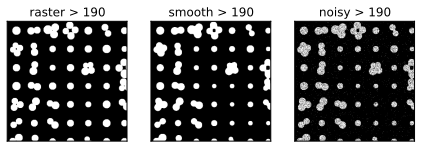

In [4]:
from skimage.filter import threshold_adaptive, threshold_otsu
THRESHOLDS = [150, 170, 190]

for thresh in THRESHOLDS:
    global_thresh = [(img > thresh) for img in BIG3GRAY]
    namesout = ['%s > %s' % (NAMES[i], thresh) for i in range(3)]
    multishow(global_thresh, names=namesout, **SHOWARGS);

In [5]:
from pyparty.tools.arraytools import segment_summary

best_thresh = [(img > 170) for img in BIG3GRAY]

for idx, img in enumerate(best_thresh):
    fp, fn, diff = segment_summary(img, binary)
    print 'fp %s (px)   fn %s (px)   |difference| %.1f%%' % (fp, fn, diff*100.0)

fp 0 (px)   fn 0 (px)   |difference| 0.0%
fp 8816 (px)   fn 1833 (px)   |difference| 4.1%
fp 10666 (px)   fn 13464 (px)   |difference| 9.2%


ymin 7.4%, xmin 187


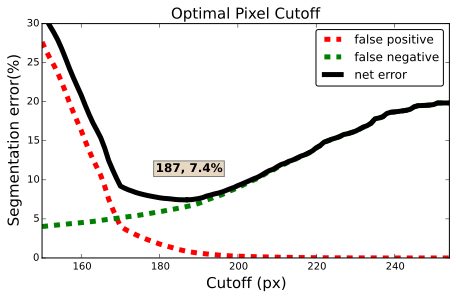

In [6]:
THRESHOLDS = range(150,255)
IMAGE = BIG3GRAY[2] #Noise
TEXT = {'fontsize':12, 'family':'fantasy', 'weight':'bold', 
        'bbox':{'facecolor':'tan', 'alpha':0.5}}

out = []
for thresh in THRESHOLDS:
    seg = IMAGE > thresh 
    out.append(segment_summary(seg, binary))

fp, fn, _ = zip(*out)
fp = 100* (np.array(fp) / PIXELAREA)
fn = 100* (np.array(fn) / PIXELAREA)
net = fp + fn

xbest, ybest = THRESHOLDS[np.where(net ==min(net))[0]], min(net)
print 'ymin %.1f%%, xmin %i' % (ybest, xbest)

plt.plot(THRESHOLDS, fp, ls='--', color='r', lw=5)
plt.plot(THRESHOLDS, fn, ls='--', color='g', lw=5)
plt.plot(THRESHOLDS, net, color='k', lw=5)
plt.ylabel('Segmentation error(%)', size=TEXTSIZE)
plt.xlabel('Cutoff (px)', size=TEXTSIZE)
plt.title('Optimal Pixel Cutoff', size=TEXTSIZE)
#lt.title("Positive, Negative and Net Difference in Global Threshold vs. Noisy Image")
plt.legend(['false positive', 'false negative', 'net error'])

# Annotate
plt.scatter(xbest, ybest, color='black')
plt.text(xbest - 8, 11, '%s, %.1f%%' % (xbest, ybest), **TEXT)

plt.ylim(0,30)
plt.xlim(THRESHOLDS[0], THRESHOLDS[-1]);
plt.savefig('/media/backup/Dropbox/Writeups_Notes_and_Applications/PLANNED_PAPERS/III-VII_SEMSUMMARY/FIFTHDRAFT_NEW_IMAGES/thiklines.png')

We see that in this case, the global threshold worked pretty well, even for the noisy image, getting to about 8% error; however, the image at this point still has non-helpful particles (because polluted with noise).  

### Output px > 187 (best global threshold)

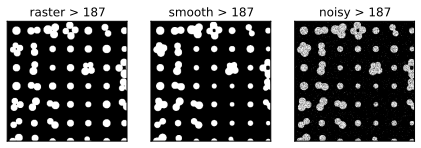

In [7]:
BESTTHRESH = 187
best_images = [(img > BESTTHRESH) for img in BIG3GRAY]
namesout = ['%s > %s' % (NAMES[i], BESTTHRESH) for i in range(3)]
#namesout=[] #No Title
multishow(best_images, names=namesout, **SHOWARGS);
#plt.savefig('/media/backup/Dropbox/Writeups_Notes_and_Applications/PLANNED_PAPERS/III-VII_SEMSUMMARY/FIFTHDRAFT_NEW_IMAGES/px187.png';

**Verdict**:
   - Simple to use
   - Works well when background is separated from particles completely
       - Smoothing adds error, and noise completely rends it infeasable.

### Adaptive Thresholding

:: DESCRIPTION ::

Let's define a quick function to colorize a boolean array for plotting purposes.  Basically, we up-convert a boolean array to (1,1,1) and (0,0,0) values, then just multiply any rgb value to achieve desired color.

In [8]:
from pyparty.utils import any2rgb, to_normrgb

def cbinary(boolarray, color = 'orange'):
    color = to_normrgb(color)
    return any2rgb(boolarray) * color

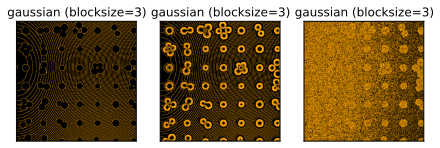

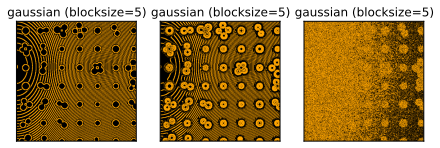

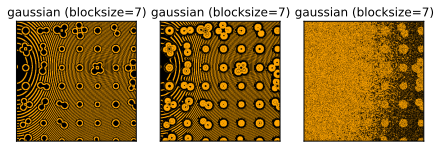

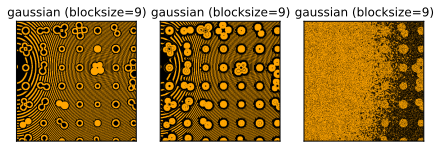

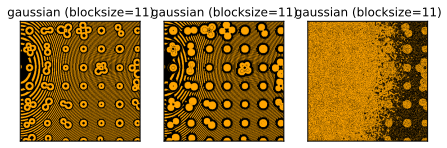

...

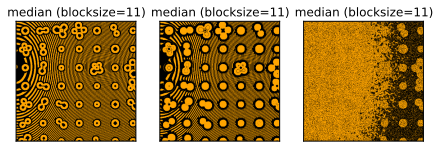

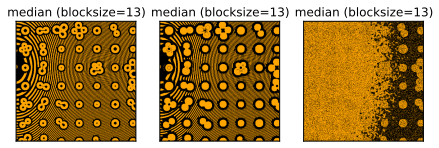

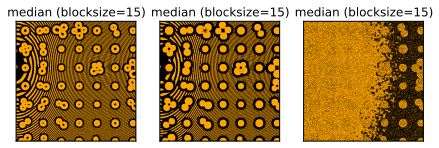

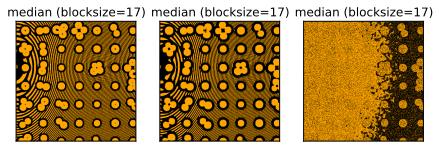

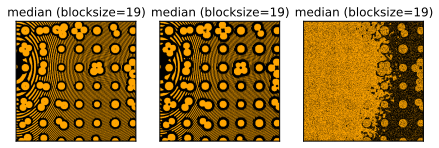

In [9]:
for method in ['gaussian', 'mean', 'median']:
    for blocksize in range(3, 21):
        if blocksize % 2:
            adapts = [threshold_adaptive(img, blocksize) for img in BIG3]
            adapts = map(cbinary, adapts)
            multishow(adapts, title='%s (blocksize=%s)' % (method, blocksize), **SHOWARGS);

**Verdict**:
   - Highly susceptable to noise and background.
   - Actually seems to work better on smoothed particles.
   - Probably outperforms global thresh in a myriad of cases, but not in these images.

### Local Otsu

Scikit-image has gloabl and local otsu utilities.  Global Otsu returns merely returns an estimate for a global threshold value, so it is useful if optimizing the global threshold is not an option!  We will concern ourself only with the local otsu function ([see local otsu example on scikit image](http://scikit-image.org/docs/dev/auto_examples/plot_local_otsu.html)).

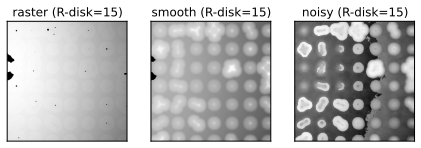

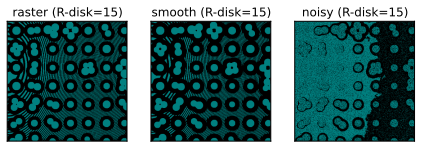

In [10]:
from skimage.filter import rank
from skimage.morphology import disk

radii = [5,10, 15, 20]
for idx, radius in enumerate(radii):
    local_otsu = [rank.otsu(img, disk(radius)) for img in BIG3GRAY]
    otsu_mask = [(BIG3GRAY[i] > local_otsu[i]) for i in range(3)]
    otsu_mask = [cbinary(mask, color='teal') for mask in otsu_mask]

    namesout = ['%s (R-disk=%s)' % (NAMES[i], radius) for i in range(3)]
    if idx == 2:
        multishow(local_otsu, names=namesout, **SHOWARGS)
        multishow(otsu_mask, names=namesout, **SHOWARGS);

**Verdict**:
   - Consistently located full particles.  
   - Less variability in identifid particle than adaptive thresholding.
   - Too computationally intensive to do a structure parameter optimization on a local machine for high-scale images.
   - Structure parameter morphology also may affect results significantly.

### Canny Edge Detection

12/15 - More notes on canny from wikipedia and mathworks:
   - Mathworks says canny is the most powerful edge detection algorithm, an dcompares it against sobel.
   - Canny gives more details in fine edges, so it can detect intra-particle boundaries nicely; however, will also get a lot of edges on the noise.  These noisy edges are also called "streaks".
   - Hysteresis thresholding (yes, hysteresis is a thresholding algorithm) is key to removing bad edges.  The main idea is that there's not a single threshold that classifies the gradient as an edge vs. noise.  **Hysteresis makes the assumption that important edges lie along a coninuous curve.**  By applying a high threshold, canny marks the edges that we are fairly sure are valid.
   - A single limit threshold often leads to streaks because a line may at some point fluctuate above or below this (or something)
   - Hypothetically, if single limit is low, you'll get too much streaking.  If it's high, you'll get bad connectivity.
   - A double limit removes streaks as such:
      - We define an upper limit above which, any pixel is immediately kept.
      - We define a lower limit below which, any pixel is immediately rejected.
      - Points that lie between the threshold are kept if they "exhitbit strong response" (what?)
         - Another explanation (wiki) sort of says start on high edges only, so aren't likely to to start with faint edges.
         
     
      
** Hysteresis thresholding is why canny give fine edges **, because it uses ideas that if you're in between regions of high signal (say between two particles), then the threshold should be more true...
   
Learned most of this here:
http://homepages.inf.ed.ac.uk/rbf/CVonline/LOCAL_COPIES/MARBLE/low/edges/canny.htm

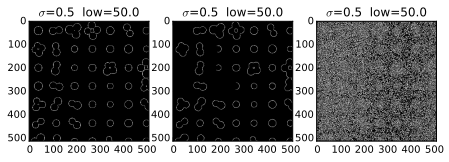

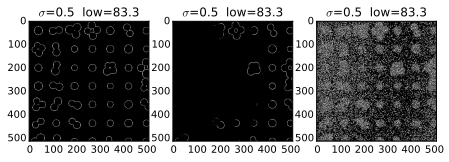

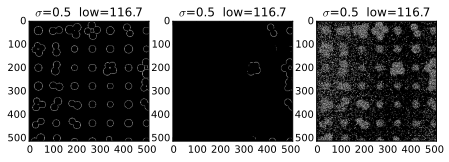

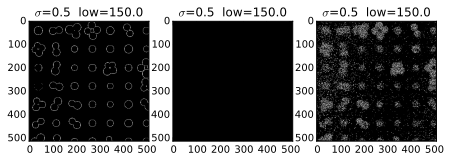

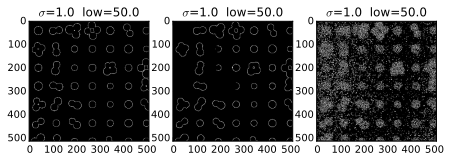

...

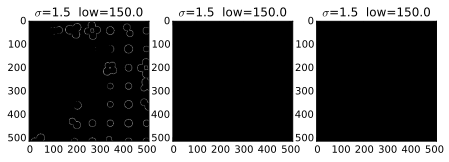

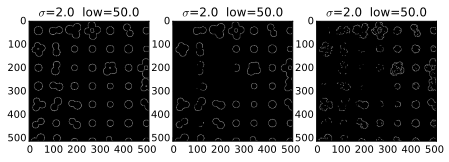

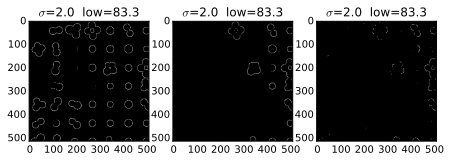

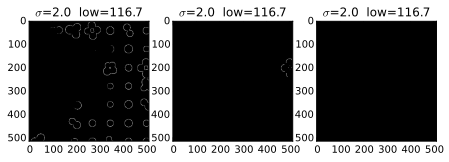

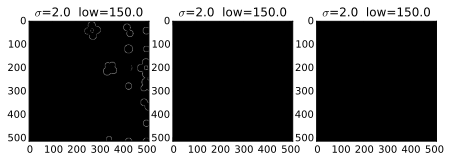

In [66]:
from skimage.filter import canny

sigmas = np.linspace(.5,2,4)
thresh = np.linspace(50,150,4)
        
for i in range(4):
    for j in range(4):        
        can_seg = [canny(img, sigmas[i], thresh[j]) for img in BIG3GRAY]
        multishow(can_seg, title='$\sigma$=%.1f  low=%.1f' % (sigmas[i], thresh[j]));        

*We see that the smoothed edges drastically hamper canny.*  The best setting for the lot seemed to be $\sigma=1.0$ and lower threshold = 50.  Therefore, we will use these values and try to fill holes, showing that filling the holes is not quite so easy.

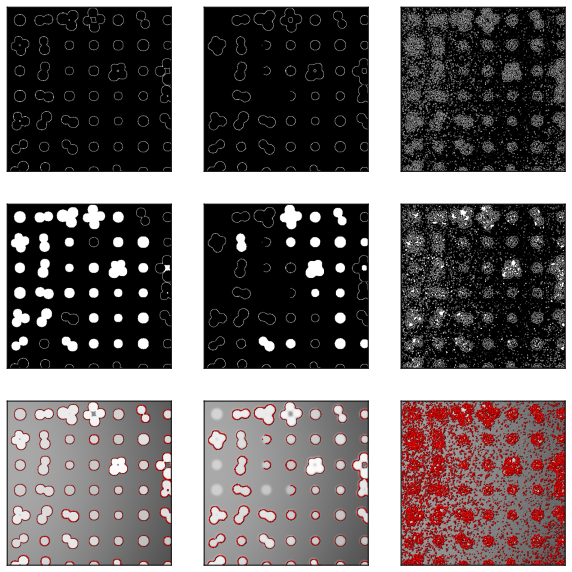

In [68]:
from scipy.ndimage import binary_fill_holes
from skimage.segmentation import mark_boundaries as mbounds

best_canny = [canny(img, 1.0, 50.0) for img in BIG3GRAY]
filled = map(binary_fill_holes, best_canny)
overlays = ([mbounds(BIG3GRAY[i], filled[i], (1,0,0) ) for i in range(3)] )

multishow(best_canny + filled + overlays, ncols=3, figsize=(10,10), **SHOWARGS);


We can see that the edges are pretty spot on...

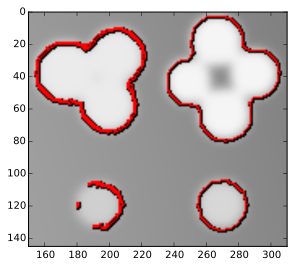

In [75]:
from pyparty.utils import zoom

zoom(overlays[1], coords=(150,0,310,145));

**Verdict**:

   - Edges are spot on.
   
   - Not affected by local background 
   
       - but could not find compromise between $\sigma$ and low parameters that also removed noise
      
   - Affectied **signficantly** by smoothing (many missing edges).
   
   - Incomplete binary closing is a problem.
   
This is not a viable method for thresholding IMO due to having 2 parameters and a possible structure parameter in closing.  This is a viable way of detecting edges; however, if careful overlays or particle measurements could assist in other tasks

### Watershed / Region-based Segmentation

Watershedding is a form of region-based segmentation that requries markers to specify regions that are veritably background and regions that are veritably the nanoparticles (or more generally, the object of interest).  Markers are also requried for supervised graph-based segmentation algorithms.  Because this is artificial data, we can easly generate valid markers; however, this may not always be the case with real images.  Tools like **weka** and **Ilastik** provide nice wand tools for user marker assignment.  Automatic methods for assigning markers are commonplace; here is an example from skimage [based on region of low gradient](http://scikit-image.org/docs/dev/auto_examples/plot_marked_watershed.html).

Because I have the binary image handy, I'm going to generate markers by simply adding black or white pixels via noise to the image at various coverage.  This will screen out regions of interest, effectively making markers.  First, let's define a function that will assign markers to a specified percentage based on number of white pixels in binary image:

In [14]:
from pyparty.noise import salt, pepper

# Bright green particle markers
p_markers = [pepper(binary, fill) for fill in (.75, .85, .95, .99)]
p_markers = [cbinary(img , (1,0,0)) for img in p_markers] # red markers

# Add to utils
def seed_mask(binaryimage, fill=0.05, step=.05, label=None):
    """ Takes binary image where objects are assumed white and backgroud black and
    adds black noise to it until the white pixels remaing are less than the percentage specified
    where perecent is mesaured realtive to the total image area.  Label is if one wants
    to assign an integer value to where the markers are"""
    binaryimage = binaryimage.astype(bool)
    noise = pepper    

    length, width = binaryimage.shape[0:2]
    whitepix = sum(binaryimage) / float((length * width))
    if fill > whitepix:
        raise AttributeError('Desired fill (%.2f) exceeds white pixel coverage (%.2f) in binary image' % (fill, whitepix))

    # Add black noise until white pixels fall below desired         
    n = 1
    while whitepix > fill:
        noisy = noise(binaryimage, step*n)
        whitepix = sum(noisy) / float((length * width))
        n += 1
        
    if label:
        noisy = noisy.astype('uint') * label
    return noisy

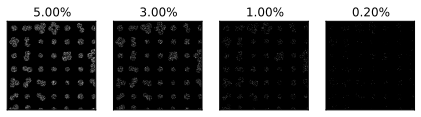

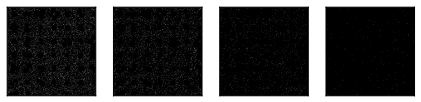

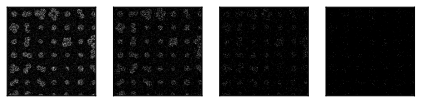

In [15]:
MARKERFILL = (0.05, 0.03, 0.01, 0.002)
p_markers = [seed_mask(binary, fill, step=0.001, label=2)
                  for fill in MARKERFILL]
bg_markers = [seed_mask(np.invert(binary), fill, step=0.001, label=1) 
                  for fill in MARKERFILL]

MNAMES=['%.2f%%' %(100*s) for s in MARKERFILL]
multishow(p_markers, names=MNAMES, **SHOWARGS)
multishow(bg_markers, **SHOWARGS)

# Add markers itemwise
net_markers = [ m1 + m2 for m1,m2 in zip(p_markers, bg_markers)]
multishow(net_markers, **SHOWARGS);

Next we require an elevation map, basically the second derivative, based on the sobel operator in this case.  The elevation map is signifcantly different based on the edges and presence of noise, probably accounting for the most variability in the subsequent watershedding. 

### Sobel edges: Image Gradient

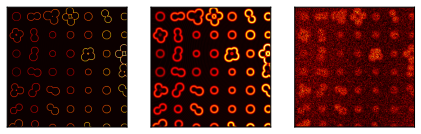

In [12]:
from skimage.filter import sobel

elevations = map(sobel, BIG3GRAY)
multishow(elevations, cmap='hot', **SHOWARGS); 
#plt.savefig('/media/backup/Dropbox/Writeups_Notes_and_Applications/PLANNED_PAPERS/III-VII_SEMSUMMARY/FIFTHDRAFT_NEW_IMAGES/sobel_mask_hot.png')


We can create a mask of the sobel edges by keeping all values greater than a certain brightness value.  Sobel returns a normalized image (values between 0-1), so our mask of 0.035 is roughly $0.035 \times 255$ or 9 pixels on the scale of the original image (0-255)

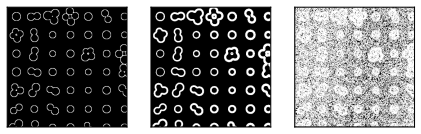

In [51]:
sobel_masks = [e > 0.035 for e in elevations]
multishow(sobel_masks, **SHOWARGS); 
#plt.savefig('/media/backup/Dropbox/Writeups_Notes_and_Applications/PLANNED_PAPERS/III-VII_SEMSUMMARY/FIFTHDRAFT_NEW_IMAGES/sobel_binary.png')

Finally, we can fill the holes in.

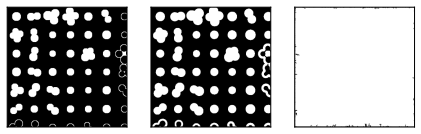

In [46]:
sobel_filled = map(binary_fill_holes, sobel_masks)
multishow(sobel_filled, **SHOWARGS); 

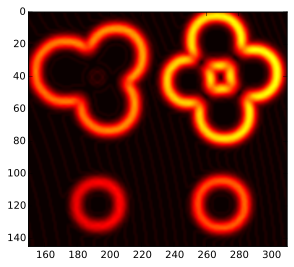

In [74]:
zoom(elevations[1], cmap='hot', coords=(150,0,310,145));

It's worth noting that although the background on the above pic looks black, it actually has some color that's very dim because the gradient is a continuous function.  We only want to retain the portions of that colored image that fall in the "mask" region that we've defined earlier.  I'll multiply the colored gradient image by the masked image and that will give me only the edges that fall in our threshold, but still colored.

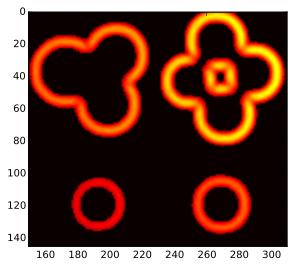

In [90]:
e1 = elevations[1]
m1 = sobel_masks[1]
masked_colors = e1*m1
zoom(masked_colors, cmap='hot', coords=(150,0,310,145));

Finally, we apply the watershed using the elevation and the combined foreground/background markers.  Labels of 1 and 2 were used for markers; for outputting binary image in color, we subtract 1 and convert to bool then color.

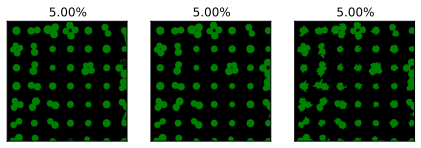

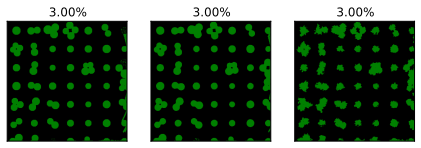

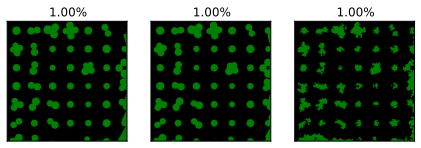

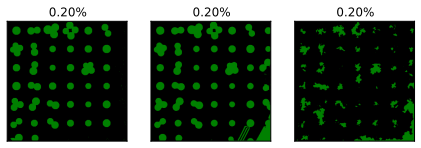

In [20]:
from skimage.morphology import watershed

for idx, markers in enumerate(net_markers): 
    row_watershed = [watershed(elev, markers) for elev in elevations]
    watercolor = [cbinary((img-1).astype(bool), color='green') for img in row_watershed]
    multishow( watercolor, title=MNAMES[idx], **SHOWARGS );

**Verdict**:

   - Handles noise better than other methods.
   
   - Smoothed image may actually give better regions.
       - Better boundaries and some particles are in smoothed that are not found in rasterized image
         
   - Boundary effects are significant.
   
   - Requires markers.

### Random Walker Segmentation

Leo Grady's [X] algorithm treat's the image as a topographic map and solves aniostropic diffusion; in others, how would a particle diffuse via random walk through the image if the pixel intensity corresponds to a weighted barrier.

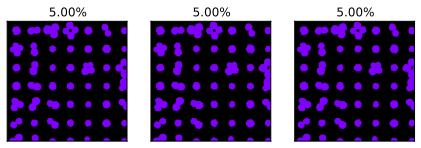

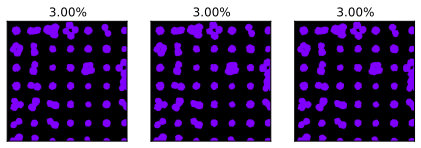

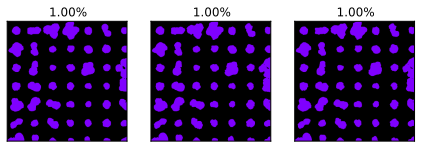

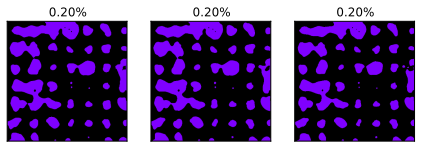

In [21]:
from skimage.segmentation import random_walker

for idx, markers in enumerate(net_markers):
    walker_segmented = [random_walker(img, markers, beta=10, mode='bf') for img in BIG3GRAY]
    walkercolor = [cbinary((img-1).astype(bool), color='#7F00FF') for img in walker_segmented]
    multishow( walkercolor, title=MNAMES[idx], **SHOWARGS );

**Verdict**:

   - Outperforms watershedding:
        - Less impact of noise; no boundary effects handling
   
   - Requires markers.
   
   - No "surprisingly absent" particles; however, at low marker density, some begin to shrink to nothing.
   
   - Less jagged boundaries in noisy image.
        
   - Default parameters worked nicely for our data; other image types may require more parameter munging.

### How many markers do I actually need?

<font color='red'>Don't forget this is ONLY a valid statistic for this particular image, and is not necessarily true in general.</font>.  **THIS MAY TAKE A WHILE TO RUN IF DATAPOINTS IS LARGE**.  Now, for one of the images (IMG_IDX), we plot the segmentation accuracy (which is the net false positives and false negatives) as function of marker density.

In [22]:
walker_diffs=[] ; shed_diffs=[]

IMG_IDX = 2 # 0 raster, 1 smooth, 2 for noise

DATAPOINTS = 30
PPOINTS =  np.linspace(.05, .002, DATAPOINTS)
p_markers = [seed_mask(binary, fill, step=0.001, label=2)
                  for fill in PPOINTS]
bg_markers = [seed_mask(np.invert(binary), fill, step=0.001, label=1) 
                  for fill in PPOINTS]

net_markers = [ m1 + m2 for m1,m2 in zip(p_markers, bg_markers) ] 

# Could also reduce boilerplate here by making a markers to summary method ro something
for (idx, markers) in enumerate(net_markers):
    
    print 'on index %s of %s' %(idx, len(net_markers))
    
    shed_segmented = watershed(elevations[IMG_IDX], markers)
    shed_mask = (shed_segmented-1).astype(bool)

    walker_segmented = random_walker(BIG3GRAY[IMG_IDX], markers, beta=10, mode='bf') 
    walker_mask = (walker_segmented-1).astype(bool)
    
    # Call segment summary and store diff (toss fp, fn)
    shed_diffs.append( segment_summary(shed_mask, binary)[2] )
    walker_diffs.append( segment_summary(walker_mask, binary)[2] )

on index 0 of 30
on index 1 of 30
on index 2 of 30
on index 3 of 30
on index 4 of 30
on index 5 of 30
on index 6 of 30
on index 7 of 30
on index 8 of 30
on index 9 of 30
on index 10 of 30
on index 11 of 30
on index 12 of 30
on index 13 of 30
on index 14 of 30
on index 15 of 30
on index 16 of 30
on index 17 of 30
on index 18 of 30
on index 19 of 30
on index 20 of 30
on index 21 of 30
on index 22 of 30
on index 23 of 30
on index 24 of 30
on index 25 of 30
on index 26 of 30
on index 27 of 30
on index 28 of 30
on index 29 of 30


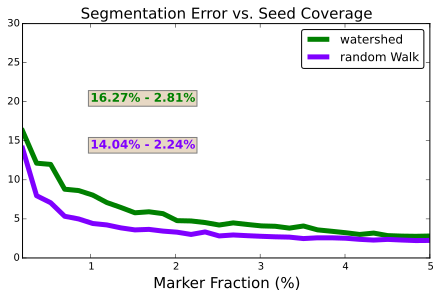

In [35]:
def perc(x): return x*100.0

xvals = map(perc, PPOINTS)
shed_percdiff = map(perc, shed_diffs)
walker_percdiff = map(perc, walker_diffs)
# Scale percent error by 100
plt.plot(xvals, shed_percdiff, color='green', lw=5)
plt.plot(xvals, walker_percdiff, color=('#7F00FF'), lw=5)

plt.title('Segmentation Error vs. Seed Coverage', size=TEXTSIZE)
plt.xlabel('Marker Fraction (%)', size=TEXTSIZE)
plt.ylabel('Segmentation Error (%)', size=TEXTSIZE)
plt.xlim(xvals[-1], xvals[0])
plt.legend(['watershed', 'random Walk'], loc='upper right');

def maxmin(items): return '%.2f%% - %.2f%%' % (items[-1], items[0])

plt.text(1, 14, maxmin(walker_percdiff), color='#7F00FF', **TEXT)
plt.text(1, 20, maxmin(shed_percdiff), color='green', **TEXT);
plt.ylim(0,30)

#plt.savefig('/media/backup/Dropbox/Writeups_Notes_and_Applications/PLANNED_PAPERS/III-VII_SEMSUMMARY/FIFTHDRAFT_NEW_IMAGES/gpthick_ylim.png')

### References

- [1] : Leo Grady.  Random walks for image segmentation. *IEEE transactions on pattern analysis and machine intelligence*, 28(11):1768-83, Novermber 2006.

### Related

- pyparty: https://github.com/hugadams/pyparty

### Redistribution

This notebook is free for redistribution.  If referencing, please cite as:

- Hughes, A. (2012). [A Computational Framework for Plasmonic Nanobiosensing](https://www.researchgate.net/publication/236672995_A_Computational_Framework_for_Plasmonic_Nanobiosensing).  Python in Science Conference [SCIPY]. 